# Parse TCB Bank Statement PDF using ORCParser

This notebook demonstrates how to use `ORCParser` to parse the `tcb_3pages.pdf` file.

ORCParser uses block detection and LLM-guided region extraction to parse documents more accurately.


In [1]:
import os
import time
import re
from pathlib import Path
from IPython.display import display, Markdown, Image as IPythonImage
from PIL import Image, ImageDraw, ImageFont

from aicapture import OCRParser, create_default_vision_model


In [2]:
user_prompt = """
You are given an image document. If this is a screenshot of a customer's mobile banking app, use the following extraction instructions exactly. 
    ```
    Extract all customer information from the mobile banking app screenshot only. Ignore all other documents.

    Also, extract the screenshot date if present. The screenshot date is usually written by the employee when taking the screenshot, or is generated by the camera app when the screenshot is captured. Additionally, extract the device (mobile) display date if it is present or visible on the screenshot. The device display date is the date shown on the phone's interface, status bar, or within the banking app as displayed by the device. The device (mobile) display date should be in date format (DD/MM/YYYY) only; if you cannot extract a valid date format, ignore it and do not extract.

    Return the result as Markdown, showing only the following sections and only the fields that have visible data:

    Rules:
    - Extract every digit exactly as shown for account numbers (no spaces, no dropped leading zeros). Account number should be 10–16 digits.
    - For the transaction amount: Convert to number with no thousands separator, use period (.) as decimal separator, remove currency symbols.
    - Transaction datetime: Input for datetime will be in format DD/MM/YYYY (e.g., 25/12/1990). Output datetime exactly as DD/MM/YYYY in all cases, with time (hh:mm:ss) if present. Do NOT convert to other formats.
    - Extract the screenshot date only if it is written or visible in the image (for example: the date handwritten or added by the employee or as an overlay from the device/app).
    - Extract the device (mobile) display date only if it is directly shown or visible on the screen, for example in the status bar or as part of the app interface. The device (mobile) display date must be in date format (DD/MM/YYYY). If it cannot be extracted in date format, ignore it and do not extract.
    - The 'Mã giao dịch' (transaction code) must be shown in a separate row, not included in other content. It is the single unique identifier string displayed.
    - Do not invent data. Only extract information actually present in the screenshot.
    - Omit any field that is not present or not visible.
    - Do not extract or mention any details from ID cards, employee badges, or any other objects.
    - Output only the Markdown, with no explanation or extra text.
    ```
    
    If the document is a bank statement, use the following extraction instructions exactly:
    ```
    Extract ALL relevant text from this document.

    This document could be:
    - Bank Statement (Sao kê ngân hàng)

    **EXTRACT ALL INFORMATION INCLUDING**:

    1. **BANK STATEMENT INFORMATION** (if present):
    - Bank name (Tên ngân hàng: Techcombank, VPBank, Vietcombank, etc.)
    - Account holder name (Chủ tài khoản)
    - Account numbers (Số tài khoản) - extract ALL accounts if multiple
    - Account nicknames/aliases (Biệt danh, Tên tài khoản) - e.g., BELLAZO, NGOCZO
    - Branch information (Chi nhánh, Mở tại)
    - Account balances (Số dư) - extract ALL if multiple accounts
    - Statement period (Kỳ sao kê, Từ ngày, Đến ngày)
    - Transaction history:
    * Transaction dates and times (Ngày giờ giao dịch) - EXTRACT ALL
    * Transaction amounts (Số tiền giao dịch) - EXTRACT ALL
    * Transaction codes/references (Mã giao dịch, FT..., MBVCB...) - EXTRACT ALL
    * Transaction descriptions (Nội dung giao dịch) - EXTRACT ALL
    * Transaction status (Trạng thái: thành công, thất bại, chờ xử lý)
    * Sender/Receiver information (Người gửi/Người nhận)
    - Interest rates (Lãi suất)
    - Fees and charges (Phí giao dịch)

    **CRITICAL INSTRUCTIONS**:
    - Extract **ALL** transactions, accounts, and entries - DO NOT LIMIT
    - If document is a bank statement, extract ALL banking info
    - If document is an identity card, extract ALL identity info
    - Keep information grouped by document type

    **EXCLUDE/IGNORE**:
    - Phone status (signal strength, battery, time on phone)
    - App UI elements (navigation bars, buttons, icons not related to data)
    - Marketing banners unrelated to transactions
    - Product labels (drinks, food, merchandise)
    - Background objects in photos
    - Device information
    - Screenshots metadata
    - Non-financial notifications
    - General advertisements
    - QR codes content (unless transaction-related)

    **TRANSLATION RULES**:
    - Keep proper nouns unchanged (bank names, person names)
    - Preserve numbers, dates, and codes exactly as shown
    - Keep currency symbols (VND, USD, EUR)

    **OUTPUT FORMAT**:
    - Clean, structured text
    - Group by document type if multiple types present
    - Preserve numerical accuracy exactly
    - Maintain chronological order for transactions
    - Remove duplicate information
    - Include ALL data found (no truncation)
    - Display transaction history in markdown table format. dont include opening balance, closing balance in the table.

    **EXAMPLES**:
    Bank Statement: Include ALL transactions, ALL accounts, ALL nicknames
"""

In [ ]:
# Configuration
pdf_path = "./data/tcb_3pages.pdf"
cache_dir = "./tmp/.orc_cache"

# Verify PDF exists
if not Path(pdf_path).exists():
    raise FileNotFoundError(f"PDF not found: {pdf_path}")

print(f"PDF path: {pdf_path}")
print(f"PDF exists: {Path(pdf_path).exists()}")


PDF path: tcb_3pages.pdf
PDF exists: True


In [4]:
# Initialize ORCParser with auto-detected vision model
vision_model = create_default_vision_model()
print(f"Using vision model: {vision_model.__class__.__name__}")
print(f"Model: {vision_model.model}")

# Create ORCParser instance
# Set invalidate_cache=True to force reprocessing
parser = OCRParser(
    vision_model=vision_model,
    invalidate_cache=False,  # Set to True to force reprocessing
    image_quality="high",
    # prompt=user_prompt,
)


2025-11-16 13:25:17.496 | INFO     | aicapture.vision_models:create_default_vision_model:32 - Creating vision model for provider: gemini
2025-11-16 13:25:17.496 | DEBUG    | aicapture.vision_models:__init__:135 - Using GeminiVisionModel
API Key: AIza***********************************
API Base: https://generativelanguage.googleapis.com/v1beta/openai/
Model: gemini-2.5-pro

2025-11-16 13:25:17.497 | DEBUG    | aicapture.cache:__init__:360 - Initialized image cache at tmp/.orc_cache/images
2025-11-16 13:25:17.498 | DEBUG    | aicapture.cache:__init__:80 - Initialized file cache at tmp/.orc_cache


Using vision model: GeminiVisionModel
Model: gemini-2.5-pro


In [5]:
import nest_asyncio
nest_asyncio.apply()

# Process the PDF
print(f"Processing PDF: {pdf_path}")
start_time = time.time()

result = parser.process_pdf(pdf_path)

elapsed_time = time.time() - start_time
print(f"\nProcessing completed in {elapsed_time:.2f} seconds")


2025-11-16 13:25:17.507 | DEBUG    | aicapture.vision_parser:_validate_and_setup:442 - Starting to process PDF file: tcb_3pages.pdf
2025-11-16 13:25:17.511 | DEBUG    | aicapture.vision_parser:_validate_and_setup:452 - Calculated file hash: c6f3916ad7a0623b35de0f98d5b9e7df8a5c8e225e087c4f3706ff452448cdee
2025-11-16 13:25:17.519 | INFO     | aicapture.cache:get:108 - Loading cached result from tmp/.orc_cache/c6f3916ad7a0623b35de0f98d5b9e7df8a5c8e225e087c4f3706ff452448cdee_aabd0965154b965cecc7f1a31ec632cba3643014c404a5bca1f394ac0d2a8a52.json
2025-11-16 13:25:17.520 | INFO     | aicapture.cache:get:263 - Found result in file cache
2025-11-16 13:25:17.520 | DEBUG    | aicapture.vision_parser:process_pdf_async:601 - Found cached results - using cached data
2025-11-16 13:25:17.522 | INFO     | aicapture.vision_parser:save_markdown_output:401 - Markdown output saved to tmp/md/tcb_3pages.md


Processing PDF: tcb_3pages.pdf

Processing completed in 0.02 seconds


In [6]:
# Display content for each page
for i, page in enumerate(result["file_object"]["pages"], 1):
    print(f"\n{'='*60}")
    print(f"Page {i} (Page Number: {page['page_number']})")
    print(f"{'='*60}")
    print(f"Confident Score: {page.get('confident_score', 'N/A')}")
    print(f"Confident Reason: {page.get('confident_reason', 'N/A')}")
    print(f"\nContent Preview (first 1000 characters):")
    print("-" * 60)
    print(page["page_content"][:1000])
    if len(page["page_content"]) > 1000:
        print(f"\n... (truncated, total length: {len(page['page_content'])} characters)")
    print("-" * 60)



Page 1 (Page Number: 1)
Confident Score: 95
Confident Reason: Document is a clear scan, but has typical 'CamScanner' artifacts like a watermark and slight perspective distortion. All text and numbers are legible. A red stamp partially obscures some numbers in the balance column, but they can still be read with high confidence.

Content Preview (first 1000 characters):
------------------------------------------------------------
<|ref|>text<|/ref|><|det|>[[57, 358, 233, 1172]]<|/det|>
NGÂN HÀNG TMCP KỸ THƯƠNG VIỆT NAM
Chi nhánh/Branch: BIH-PGD-TCB BINH HOA
MST/Tax code: 0100230800-022

<|ref|>text<|/ref|><|det|>[[63, 1172, 220, 2718]]<|/det|>
SỔ PHỤ KIỂM PHIẾU BÁO NỢ/CÓ
BANK STATEMENT/ DEBIT - CREDIT TRANSACTION
(Từ ngày/From 01/09/2024 Đến ngày/To 13/12/2024)

<|ref|>image<|/ref|><|det|>[[63, 3061, 137, 3579]]<|/det|>
The logo for TECHCOMBANK.

<|ref|>text<|/ref|><|det|>[[239, 2356, 393, 3302]]<|/det|>
Loại tiền/Currency: VND
Số tài khoản/Account No: 19037937850011
Loại tài khoản/Type


PAGE 1 (Page Number: 1) - IMAGE WITH BBOX FROM BATCH RESPONSE
Image size: 3895x2752 pixels
Total blocks drawn: 11

Block type colors:
  text: blue
  table: red
  figure: green
  math_formula: purple
  diagram: orange
  image: yellow


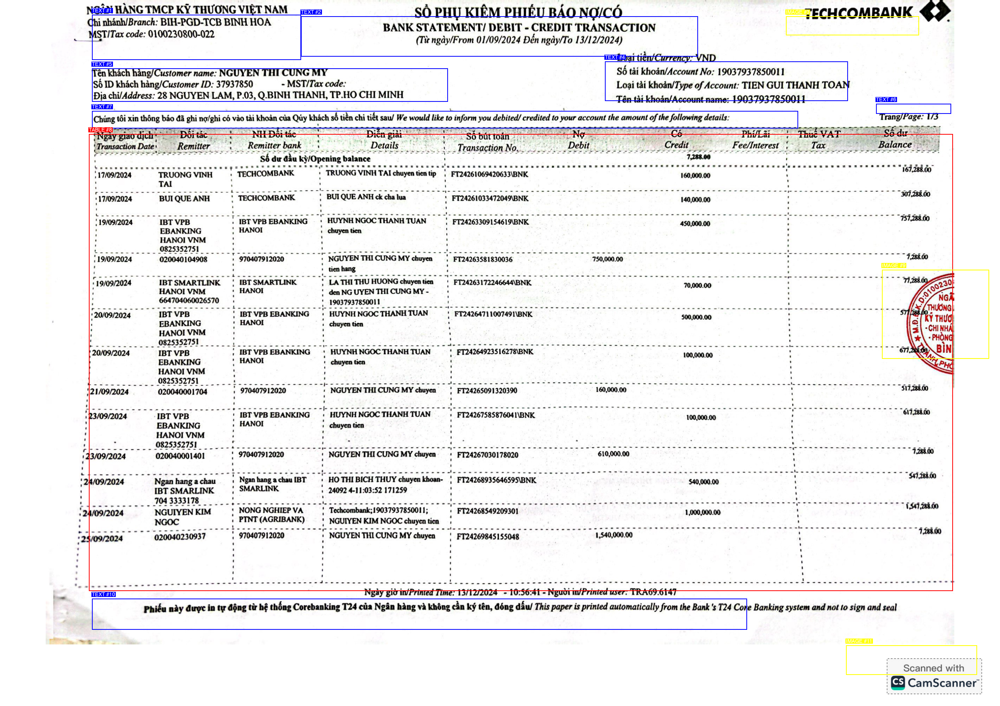


PAGE 2 (Page Number: 2) - IMAGE WITH BBOX FROM BATCH RESPONSE
Image size: 3895x2752 pixels
Total blocks drawn: 11

Block type colors:
  text: blue
  table: red
  figure: green
  math_formula: purple
  diagram: orange
  image: yellow


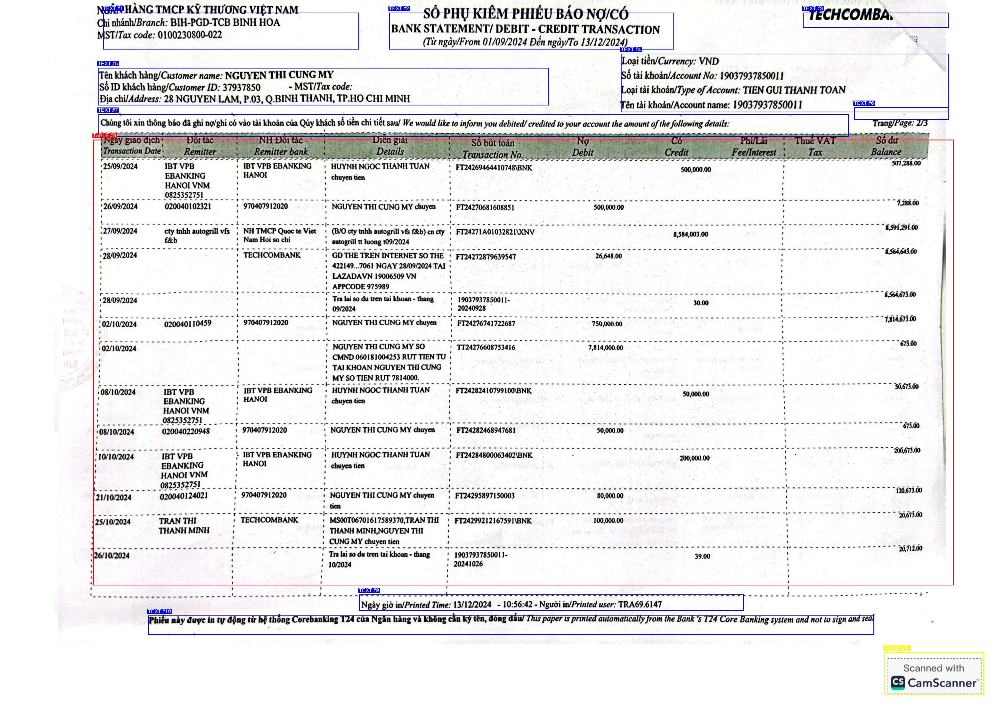


PAGE 3 (Page Number: 3) - IMAGE WITH BBOX FROM BATCH RESPONSE
Image size: 3895x2752 pixels
Total blocks drawn: 14

Block type colors:
  text: blue
  table: red
  figure: green
  math_formula: purple
  diagram: orange
  image: yellow


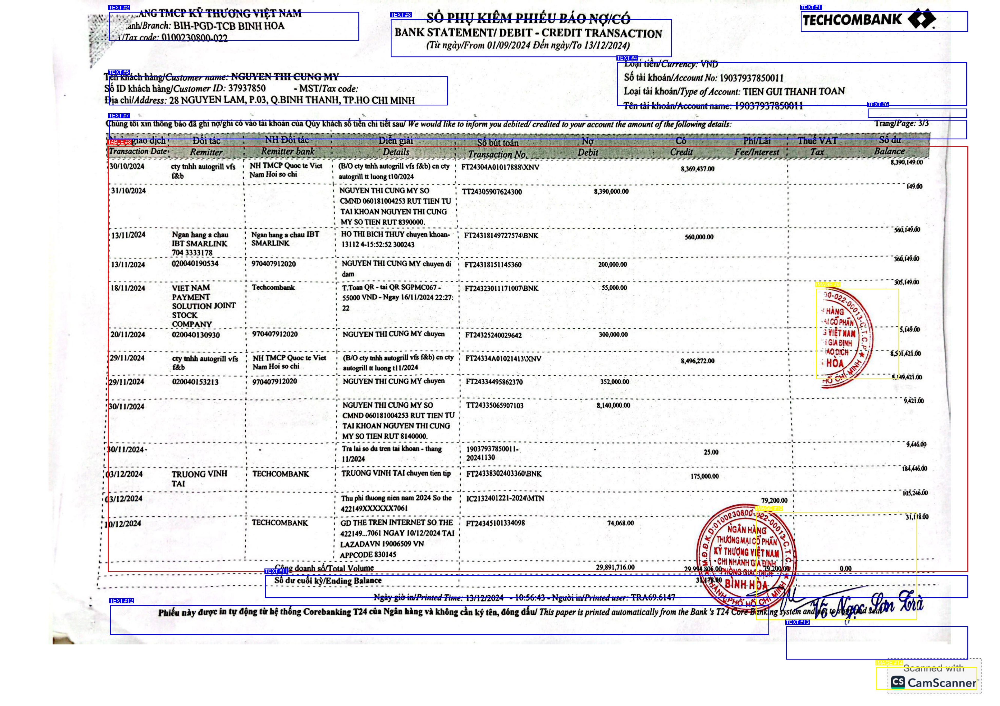

In [13]:
import functools

def extract_blocks(page_content):
    """Extracts block types and bounding boxes from annotated text lines."""
    ref_pattern = re.compile(r"<\|ref\|>(\w+)<\|/ref\|>")
    det_pattern = re.compile(r"<\|det\|>\[\[([\d,\s]+)\]\]<\|/det\|>")
    blocks = []
    lines = page_content.split('\n')
    for idx, line in enumerate(lines):
        ref = ref_pattern.search(line.strip())
        if ref:
            block_type = ref.group(1).lower()
            # bbox might be on this or the next line
            det = det_pattern.search(line)
            if not det and idx + 1 < len(lines):
                det = det_pattern.search(lines[idx + 1].strip())
            if det:
                coords = [int(x.strip()) for x in det.group(1).split(',')]
                if len(coords) == 4:
                    blocks.append({"type": block_type, "bbox": coords})
    return blocks

def swap_xy_and_clamp_box(bbox, width, height):
    # If input is [xmin, ymin, xmax, ymax], but axes are swapped, convert
    xmin, ymin, xmax, ymax = bbox
    xmin, ymin, xmax, ymax = ymin, xmin, ymax, xmax
    xmin = max(0, min(xmin, width - 1))
    ymin = max(0, min(ymin, height - 1))
    xmax = max(xmin + 1, min(xmax, width))
    ymax = max(ymin + 1, min(ymax, height))
    return [xmin, ymin, xmax, ymax]

def get_font():
    try:
        return ImageFont.truetype("/System/Library/Fonts/Helvetica.ttc", 20)
    except Exception:
        try:
            return ImageFont.load_default()
        except Exception:
            return None

def draw_blocks_on_image(img, blocks, block_colors):
    """Draw bounding boxes and labels on the image."""
    img_copy = img.copy()
    draw = ImageDraw.Draw(img_copy)
    width, height = img.size
    font = get_font()
    for idx, block in enumerate(blocks, 1):
        block_type = block["type"]
        rect = swap_xy_and_clamp_box(block["bbox"], width, height)  # [xmin, ymin, xmax, ymax]
        color = block_colors.get(block_type, "gray")
        draw.rectangle(rect, outline=color, width=3)
        label = f"{block_type.upper()} #{idx}"
        label_y = max(5, rect[1] - 25)
        # Text background for readability
        if font:
            text_bbox = draw.textbbox((rect[0], label_y), label, font=font)
            if text_bbox:
                bg_x0, bg_y0, bg_x1, bg_y1 = text_bbox
                draw.rectangle([bg_x0-2, bg_y0-2, bg_x1+2, bg_y1+2], fill=color, outline=color)
        draw.text((rect[0], label_y), label, fill="white" if font else color, font=font)
    return img_copy

block_colors = {
    "text": "blue", "table": "red", "figure": "green", "math_formula": "purple",
    "diagram": "orange", "image": "yellow"
}
cache_images_dir = Path(cache_dir) / "images"
file_hash_dirs = [d for d in cache_images_dir.iterdir() if d.is_dir()]
if not file_hash_dirs:
    print("No cached images found. Please run the processing first.")
else:
    file_hash_dir = file_hash_dirs[0]  # For simplicity, use first found
    for i, page in enumerate(result["file_object"]["pages"], 1):
        page_num = page['page_number']
        image_files = list(file_hash_dir.glob(f"p{page_num}_*.png"))
        if not image_files:
            print(f"\nPage {i} image not found in cache. Skipping visualization.")
            continue
        img = Image.open(image_files[0]).convert("RGB")
        blocks = extract_blocks(page['page_content'])
        img_with_bboxes = draw_blocks_on_image(img, blocks, block_colors)
        print("\n" + "=" * 80)
        print(f"PAGE {i} (Page Number: {page_num}) - IMAGE WITH BBOX FROM BATCH RESPONSE")
        print("=" * 80)
        print(f"Image size: {img.size[0]}x{img.size[1]} pixels")
        print(f"Total blocks drawn: {len(blocks)}")
        print("\nBlock type colors:")
        for btype, color in block_colors.items():
            print(f"  {btype}: {color}")
        display(img_with_bboxes)
